<a href="https://colab.research.google.com/github/versey-sherry/cell_segmentation_tracking/blob/main/PhC_smaller_U_Net.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# PhC Model

In [ ]:
# ! pip3 install torch torchvision

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
import os
import random
import shutil
from glob import glob

from multiprocessing.dummy import Pool

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from PIL import Image

from sklearn.model_selection import train_test_split
from sklearn.externals import joblib

from skimage.morphology import binary_opening, disk, label
from scipy import ndimage

import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.transforms.functional as TF
from random import randint
import torchvision

from torch.autograd import Variable
from torch.utils.data import DataLoader, Dataset
from torchsummary import summary
from torch.utils.tensorboard import SummaryWriter
from tqdm import tqdm
# from tqdm.notebook import tqdm

import torchvision.transforms as transforms

import gc
gc.collect()

31145

In [ ]:
  # Mounting drive
from google.colab import drive
drive.mount('/content/drive/')
BASE_DIR = '/content/drive/My Drive/ms_project/dataset'
SAVE_DIR = '/content/drive/My Drive/ms_project/dataset/saved_models'

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


### Creating new data with augmentation
One-off process for augmenting

In [ ]:
# def find_crop_region(mask):
#   # Read mask as plt image type proportion of time the biggest segmenation is selected
#   # Find the biggest mask region
#   masks = np.array(mask)
#   regions = []
#   ids = np.unique(mask)
#   # 0th is the background
#   ids = ids[1:]
#   masks = masks == ids[:, None, None]
#   for i in range(len(ids)):
#     pos = np.where(masks[i])
#     xmin = np.min(pos[1])
#     xmax = np.max(pos[1])
#     ymin = np.min(pos[0])
#     ymax = np.max(pos[0])
#     regions.append((ymin, xmin, ymax - ymin, xmax-xmin))
#   # sample uniformly to get a region
#   b1 = random.sample(regions, 1)[0]
#   top = b1[0]
#   left = b1[1]
#   height = b1[2]
#   width = b1[3]
#   if height == 0 or width ==0:
#     b1 = random.sample(regions, 1)[0]
#     top = b1[0]
#     left = b1[1]
#     height = b1[2]
#     width = b1[3]
#   return top, left, height, width

# def annote_image(img_save_dir, mask_save_dir):
#   imgs = sorted(glob(os.path.join(BASE_DIR, 'PhC-C2DH*/*/*.tif')))
#   masks = sorted(glob(os.path.join(BASE_DIR, 'PhC-C2DH*/*_GT/SEG/*.tif')))
#   global_step = 0
#   for id in range(len(imgs)):
#     # rotating whole images
#     img = Image.open(imgs[id])
#     mask = Image.open(masks[id])
#     print(imgs[id],masks[id])

#     for c in range(3):
#       top, left, height, width = find_crop_region(mask)
#       img1 = TF.crop(img, top, left, height, width)
#       mask1 = TF.crop(mask, top, left, height, width)
#       img1.save(os.path.join(img_save_dir, 'c-'+str(global_step) + 'img'+'.tif'))
#       mask1.save(os.path.join(mask_save_dir, 'c-'+str(global_step) + 'mask'+ '.tif'))
#       global_step +=1
    

# annote_image('/content/drive/MyDrive/ms_project/dataset/annotated_PhC/images', 
#              '/content/drive/MyDrive/ms_project/dataset/annotated_PhC/masks')

# len(sorted(glob(os.path.join(BASE_DIR, 'annotated_PhC/images/*.tif'))))

### Helper functions for plotting

In [ ]:
def plot_image_mask(img, mask, prediction = None):
  if prediction is not None:
    fig, axs = plt.subplots(1,3, figsize = (10,10))
    axs[0].axis('off')
    axs[0].imshow(img)
    axs[0].set_title('image')

    axs[1].axis('off')
    axs[1].imshow(mask)
    axs[1].set_title('mask')

    axs[2].axis('off')
    axs[2].imshow(prediction)
    axs[2].set_title('prediction')

  else:
    fig, axs = plt.subplots(1,2, figsize = (10,10))
    axs[0].axis('off')
    axs[0].imshow(img)
    axs[0].set_title('image')
    axs[1].axis('off')
    axs[1].imshow(mask)
    axs[1].set_title('mask')

In [ ]:
def plot_batch(imgs, masks, weights, outputs = None):
  imgs = imgs.cpu()
  masks = masks.cpu()
  if outputs is not None:
    fig, axs = plt.subplots(imgs.size()[0], 4, figsize = (20, 20))
    outputs = outputs.cpu()
  else:
    fig, axs = plt.subplots(imgs.size()[0], 3, figsize = (10, 15))

  for i in range(imgs.size()[0]):
    axs[i,0].axis('off')
    axs[i,0].set_title('image')
    axs[i,0].imshow(imgs[i].permute(1,2,0).squeeze())
    axs[i,1].axis('off')
    axs[i,1].set_title('mask')
    axs[i,1].imshow(masks[i].squeeze())
    axs[i,2].axis('off')
    axs[i,2].set_title('map')
    pos = axs[i,2].imshow(weights[i].squeeze(), cmap = 'jet')
    fig.colorbar(pos, ax = axs[i,2])
    if outputs is not None:
      softmax = nn.Softmax(dim=0)
      predict = torch.argmax(softmax(outputs[i]), dim = 0)
      axs[i,3].axis('off')
      axs[i,3].set_title('prediction')
      axs[i,3].imshow(predict)
  return fig
# plot_batch(imgs, masks, outputs)

# Dataset

In [ ]:
# Crop function with p chance to select full region
def find_crop_region(mask):
  # Read mask as plt image type proportion of time the biggest segmenation is selected
  # Find the biggest mask region
  masks = np.array(mask)
  regions = []
  ids = np.unique(mask)
  # 0th is the background
  ids = ids[1:]
  masks = masks == ids[:, None, None]
  for i in range(len(ids)):
    pos = np.where(masks[i])
    xmin = np.min(pos[1])
    xmax = np.max(pos[1])
    ymin = np.min(pos[0])
    ymax = np.max(pos[0])
    regions.append((ymin, xmin, ymax, xmax))
  # sample uniformly to get a region
  b1, b2 = random.sample(regions, 2)
  top = min(b1[0],b2[0])
  left = min(b1[1], b2[1])
  bottom = max(b1[2], b2[2])
  right = max(b1[3], b2[3])
  height = bottom - top
  width = right - left

  # Try to make the image biger
  if height < 100 or width <100:
    b1, b2 = random.sample(regions, 2)
    top = min(b1[0],b2[0])
    left = min(b1[1], b2[1])
    bottom = max(b1[2], b2[2])
    right = max(b1[3], b2[3])
    height = bottom - top
    width = right - left

  return top, left, height, width

In [ ]:
def filledRotate(img, angle, size):
  # Pdd the image
  t= transforms.Pad(200, padding_mode='reflect')
  img = t(img)
  img = TF.rotate(img, angle, expand= False)
  t = transforms.CenterCrop(size)
  img = t(img)
  return img

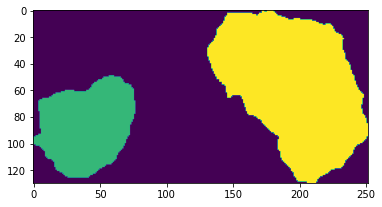

In [ ]:
# Sanity Check
mask = Image.open(sorted(glob(os.path.join(BASE_DIR, 'PhC-C2DH*/*_GT/SEG/*.tif')))[0])
top, left, height, width = find_crop_region(mask)
mask1 = TF.crop(mask, top, left, height, width)
plt.imshow(mask1)

In [ ]:
# # Compute distance mask for the mask, boundary weights 1, furthest pixel is 50 pixels, min_weight= 0.2
# def distance_mask(mask, threshold = 50):
#   # mask is a ndarray
#   # foreground is just mask
#   mask_background = np.where(mask > 0, 0, 1)
#   # process distance map for foreground
#   mask_foreground = ndimage.distance_transform_edt(mask)
#   # mask_foreground = np.where(mask_foreground < threshold, mask_foreground, 0)
  
#   mask_background = ndimage.distance_transform_edt(mask_background)
#   # mask_background = np.where(mask_background < threshold, mask_background, 0)

#   mask_foreground = mask_foreground + mask_background
#   min, max = np.min(mask_foreground), np.max(mask_foreground)
#   diff = max - min
#   # print(diff)
#   # plt.hist(mask_foreground)
#   # plt.show()
#   mask_foreground = np.where(mask_foreground > 0, 1+(1 - (mask_foreground-min)/diff), 1)
#   mask_background = torch.from_numpy(mask_foreground)
#   return mask_foreground

In [ ]:
# Compute distance mask for the mask, boundary weights 1, furthest pixel is 50 pixels, min_weight= 0.2
def distance_mask(mask, threshold = 5, w = 10):
  # mask is a ndarray
  # foreground is just mask
  mask_background = np.where(mask > 0, 0, 1)
  # background weight 1, mask weight is num(background)/num(mask)
  c_mask = np.sum(mask_background)/np.sum(mask)
  # process distance map for foreground
  mask_foreground = ndimage.distance_transform_edt(mask)
  # mask_foreground = np.where(mask_foreground < threshold, mask_foreground, 0)
  
  mask_background = ndimage.distance_transform_edt(mask_background)
  # mask_background = np.where(mask_background < threshold, mask_background, 0)

  mask_foreground = mask_foreground + mask_background
  mask_foreground = np.where(mask_foreground > 0, w * np.exp(-mask_foreground**2/(2*threshold**2)), 0)
  # mask_foreground = np.where(mask_foreground > 0, 1+ w * np.exp(mask_foreground/(2*threshold**2)), 0)
  # Assigning 1 to the background, and c_mask
  mask_foreground[mask == 0] += 1
  mask_foreground[mask == 1] += c_mask

  mask_background = torch.from_numpy(mask_foreground)
  return mask_foreground


1.0 22.056216572663246


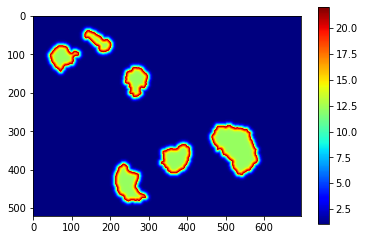

In [ ]:
# Sanity Check
mask = Image.open(sorted(glob(os.path.join(BASE_DIR, 'PhC-C2DH*/*_GT/SEG/*.tif')))[0])
mask = np.array(mask)
mask = np.where(mask > 0, 1, 0)

distance = distance_mask(mask)
print(np.min(distance), np.max(distance))

plt.imshow(distance, cmap = 'jet')

plt.colorbar()
plt.show()

In [ ]:
class ImgDataset(Dataset):
  def __init__(self, root, train = True):
    self.root = root
    self.train = train
    # self.imgs = sorted(glob(os.path.join(root, 'annotated_PhC/images/*.tif')))
    # self.masks = sorted(glob(os.path.join(root, 'annotated_PhC/masks/*.tif')))
    self.imgs = sorted(glob(os.path.join(root, 'PhC-C2DH*/*/*.tif')))
    self.masks = sorted(glob(os.path.join(root, 'PhC-C2DH*/*_GT/SEG/*.tif')))

    self.img_size = (440, 440)
    self.mask_size = (348, 348)
  
  # performing identical transform for img and mask
# https://discuss.pytorch.org/t/torchvision-transfors-how-to-perform-identical-transform-on-both-image-and-target/10606/7
  def transforms(self, img, mask, weight):
    if self.train:
      # could use random affine
      # generate random number for rotation
      img_tfms = transforms.Compose([transforms.Resize(self.img_size, interpolation=Image.BICUBIC),
                                     transforms.ToTensor(),
                                     transforms.Normalize(0.449, 0.226)])
      mask_tfms = transforms.Compose([transforms.ToTensor(),
                                      transforms.Resize(self.mask_size, interpolation=Image.NEAREST)])
      img, mask, weight = img_tfms(img), mask_tfms(mask), mask_tfms(weight)
      # Adding augmentation
      # Horizontal Flip
      if torch.rand(1) > 0.5:
        img, mask, weight = TF.hflip(img), TF.hflip(mask), TF.hflip(weight)
      # # Raondom rotation
      angle = randint(0, 360)
      img = filledRotate(img, angle, self.img_size)
      mask, weight = filledRotate(mask, angle, self.mask_size), filledRotate(weight, angle, self.mask_size)
      # https://www.oreilly.com/library/view/programming-pytorch-for/9781492045342/ch04.html
      # Random Affine
      # angle = randint(-30, 330)
      # shear_x, shear_y = randint(0, 20), randint(0,20)
      # img = TF.affine(img, angle = angle, translate=(0, 0), scale = 1.0, shear=(shear_x, shear_y)) 
      # mask = TF.affine(mask, angle = angle, translate=(0, 0), scale = 1.0, shear=(shear_x, shear_y))
    else:
      img_tfms = transforms.Compose([transforms.Resize(self.img_size, interpolation=Image.BICUBIC),
                                     transforms.ToTensor(),
                                     transforms.Normalize(0.449, 0.226)])
      mask_tfms = transforms.Compose([transforms.ToTensor(), 
                                      transforms.Resize(self.mask_size, interpolation=Image.NEAREST)])
      img, mask, weight = img_tfms(img), mask_tfms(mask), mask_tfms(weight)
    return img, mask, weight

  def __getitem__ (self, id):
    img_path = self.imgs[id]
    mask_path = self.masks[id]

    img = Image.open(img_path)
    mask = Image.open(mask_path)
    # Cropping augmentation
    if self.train:
      if torch.rand(1) > 0.5:
        top, left, height, width = find_crop_region(mask)
        img = TF.crop(img, top, left, height, width)
        mask = TF.crop(mask, top, left, height, width)
    
    # Not instance aware
    # Masks contain background and cells. background is 0th postion, cell is 1st position
    mask = np.array(mask)
    mask = np.where(mask > 0, 1, 0) 
    weight = distance_mask(mask)
    
    img, mask, weight = self.transforms(img, mask, weight)
    mask = torch.as_tensor(mask, dtype=torch.long).squeeze()
    weight = weight.squeeze()
    return img, mask, weight

  def __len__(self):
    return len(self.imags)


In [ ]:
# No longer necessary, use ImageNet mean, std instead.
# Pytorch handles normlization by target mean and std, no need to compute image stack mean and std
# Computing channel mean and channel variance
'''
def img_stat(img_files):
  # list of train image file names
  img_stack = []
  for img in img_files:
    # image only has one channel, N x W x H
    img = np.array(Image.open(img))
    img_stack.append(img)
  img_stack = np.array(img_stack)
  mean_array = np.reshape(np.mean(img_stack, axis = (1,2)), (img_stack.shape[0],1,1))
  mean= np.mean(mean_array)
  std = np.sqrt(np.mean(np.square(img_stack - mean_array)))
  return mean, std
  '''

In [ ]:
# train test split
image_list = sorted(glob(os.path.join(BASE_DIR, 'PhC-C2DH*/*/*.tif')))
torch.manual_seed(1)
indices = torch.randperm(len(image_list)).tolist()
# 20% 80% split
split = indices[:int(len(image_list) * 0.8)]
train_list = [item for ind, item in enumerate(image_list) if ind in split]
test_list = [item for ind, item in enumerate(image_list) if ind not in split]
# using the training set for channel mean
# channel_mean, channel_std = img_stat(train_list)
# print(channel_mean, channel_std)

# Prepare train/test dataset
train_set = ImgDataset(BASE_DIR, train=True)
test_set = ImgDataset(BASE_DIR, train = False)
train_set = torch.utils.data.Subset(train_set, indices[:int(len(image_list) * 0.8)])
test_set = torch.utils.data.Subset(test_set, indices[int(len(image_list) * 0.8):])

####################################
# Smaller set for debugging
# train_set = torch.utils.data.Subset(train_set, range(500))
# test_set = torch.utils.data.Subset(test_set, range(100))
####################################


# Prepare dataloader
batch_size = 4
train_dl = DataLoader(train_set, batch_size = batch_size, shuffle = True,
                      pin_memory=torch.cuda.is_available(), num_workers=0)
test_dl = DataLoader(test_set, batch_size = batch_size, shuffle = False, pin_memory=torch.cuda.is_available(), num_workers=0)

46 184


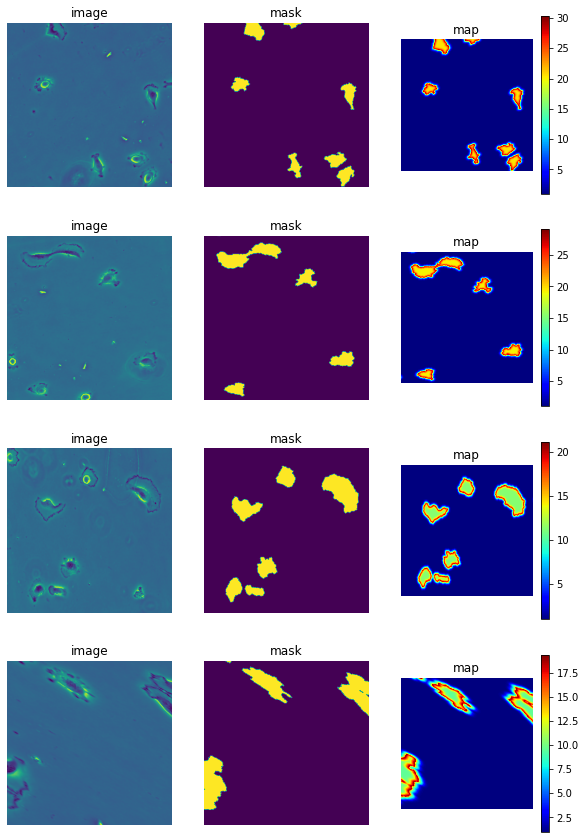

In [ ]:
imgs, masks, weights = next(iter(train_dl))
plot_batch(imgs, masks, weights)
print(len(train_dl), len(train_set))

12


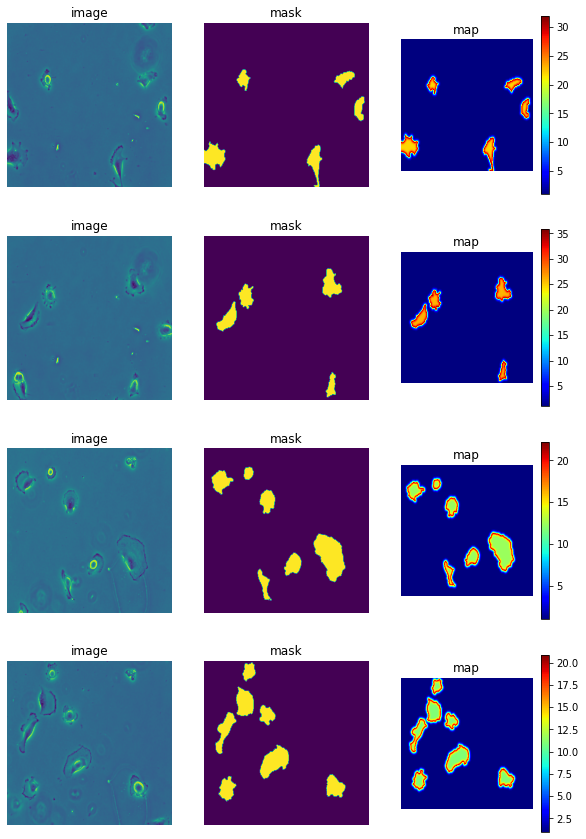

In [ ]:
imgs, masks, weights = next(iter(test_dl))
plot_batch(imgs, masks, weights)
print(len(test_dl))

# Network Structure

In [ ]:
# https://github.com/Hsankesara/DeepResearch/blob/master/UNet/Unet.py
# https://blog.paperspace.com/busting-the-myths-about-batch-normalization/
class UNet(nn.Module):
    def contracting_block(self, in_channels, out_channels, kernel_size=3):
      """
      This function creates one contracting block
      """
      # Changing earlier blocks to Leaky relu 
      # https://adventuresinmachinelearning.com/vanishing-gradient-problem-tensorflow/
      block = torch.nn.Sequential(
                  torch.nn.Conv2d(kernel_size=kernel_size, in_channels=in_channels, out_channels=out_channels),
                  torch.nn.LeakyReLU(0.1),
                  torch.nn.BatchNorm2d(out_channels, track_running_stats = False),
                  torch.nn.Conv2d(kernel_size=kernel_size, in_channels=out_channels, out_channels=out_channels),
                  torch.nn.LeakyReLU(0.1),
                  torch.nn.BatchNorm2d(out_channels, track_running_stats = False),
              )
      return block

    def expansive_block(self, in_channels, mid_channel, out_channels, kernel_size=3):
      """
      This function creates one expansive block
      """
      block = torch.nn.Sequential(
              torch.nn.Conv2d(kernel_size=kernel_size, in_channels=in_channels, out_channels=mid_channel),
              torch.nn.ReLU(),
              torch.nn.BatchNorm2d(mid_channel, track_running_stats = False),
              torch.nn.Conv2d(kernel_size=kernel_size, in_channels=mid_channel, out_channels=mid_channel),
              torch.nn.ReLU(),
              torch.nn.BatchNorm2d(mid_channel, track_running_stats = False),
              torch.nn.ConvTranspose2d(in_channels=mid_channel, out_channels=out_channels, kernel_size=3, stride=2, padding=1, output_padding=1)
              )
      return  block

    def final_block(self, in_channels, mid_channel, out_channels, kernel_size=3):
      """
      This returns final block
      """
      block = torch.nn.Sequential(
              torch.nn.Conv2d(kernel_size=kernel_size, in_channels=in_channels, out_channels=mid_channel),
              torch.nn.ReLU(),
              torch.nn.BatchNorm2d(mid_channel, track_running_stats = False),
              torch.nn.Conv2d(kernel_size=kernel_size, in_channels=mid_channel, out_channels=mid_channel),
              torch.nn.ReLU(),
              torch.nn.BatchNorm2d(mid_channel, track_running_stats = False),
              torch.nn.Conv2d(kernel_size=kernel_size, in_channels=mid_channel, out_channels=out_channels, padding=1),
              # torch.nn.ReLU(),
              torch.nn.BatchNorm2d(out_channels, track_running_stats = False),
              # Adding a 1x1 convolutional channel
              # torch.nn.Conv2d(kernel_size=1, in_channels=out_channels, out_channels=out_channels),
              # torch.nn.BatchNorm2d(out_channels, track_running_stats = False),
              )
      return  block

    def __init__(self, in_channel, out_channel):
      # in_channel is the number of in
      super(UNet, self).__init__()
      #Encode
      self.conv_encode1 = self.contracting_block(in_channels=in_channel, out_channels=64)
      self.conv_maxpool1 = torch.nn.MaxPool2d(kernel_size=2)
      self.conv_encode2 = self.contracting_block(64, 128)
      self.conv_maxpool2 = torch.nn.MaxPool2d(kernel_size=2)
      self.conv_encode3 = self.contracting_block(128, 256)
      self.conv_maxpool3 = torch.nn.MaxPool2d(kernel_size=2)
      # Bottleneck
      self.bottleneck = torch.nn.Sequential(
                          torch.nn.Conv2d(kernel_size=3, in_channels=256, out_channels=512),
                          torch.nn.LeakyReLU(0.1),
                          torch.nn.BatchNorm2d(512, track_running_stats = False),
                          torch.nn.Conv2d(kernel_size=3, in_channels=512, out_channels=512),
                          torch.nn.LeakyReLU(0.1),
                          torch.nn.BatchNorm2d(512, track_running_stats = False), 
                          torch.nn.ConvTranspose2d(in_channels=512, out_channels=256, kernel_size=3, stride=2, padding=1, output_padding=1)                   
                          )
      # Decode
      self.conv_decode3 = self.expansive_block(512, 256, 128)
      self.conv_decode2 = self.expansive_block(256, 128, 64)
      self.final_layer = self.final_block(128, 64, out_channel)
      self.weight_init()

    def crop_and_concat(self, bypass, upsampled, crop=False):
      """
      This layer crop the layer from contraction block and concat it with expansive block vector
      """
      if crop:
          c = (bypass.size()[2] - upsampled.size()[2]) // 2
          if (bypass.size()[2] - upsampled.size()[2]) % 2 == 0:
            bypass = F.pad(bypass, (-c, -c, -c, -c))
          else:
            bypass = F.pad(bypass, (-c, -c-1, -c, -c-1))
      return torch.cat((bypass, upsampled), 1)

    def weight_init(self):
      for block in self._modules:
        try:
          for layer in self._modules[block]:
            if isinstance(layer, nn.Conv2d):
              # torch.nn.init.kaiming_uniform_(layer.weight.data, mode='fan_in', nonlinearity='relu')
              # torch.nn.init.xavier_normal_(layer.weight.data, gain=nn.init.calculate_gain('relu'))
              torch.nn.init.xavier_uniform_(layer.weight.data, gain=1.0)
              # torch.nn.init.normal_(layer.weight.data, mean=0.0, std=1.0)
              
              if layer.bias.data is not None:
                layer.bias.data.zero_()
            elif isinstance(layer, nn.BatchNorm2d):
              layer.weight.data.fill_(1)
              if layer.bias.dat is not None:
                layer.bias.data.zero_()
        except:
          pass

    def forward(self, x):
      # Encode
      encode_block1 = self.conv_encode1(x)
      encode_pool1 = self.conv_maxpool1(encode_block1)
      encode_block2 = self.conv_encode2(encode_pool1)
      encode_pool2 = self.conv_maxpool2(encode_block2)
      encode_block3 = self.conv_encode3(encode_pool2)
      encode_pool3 = self.conv_maxpool3(encode_block3)
      # Bottleneck
      bottleneck1 = self.bottleneck(encode_pool3)
      # Decode
      cat_layer3 = self.crop_and_concat(encode_block3, bottleneck1, crop = True)
      decode_block3 = self.conv_decode3(cat_layer3)
      cat_layer2 = self.crop_and_concat(encode_block2, decode_block3, crop = True)
      decode_block2 = self.conv_decode2(cat_layer2)
      cat_layer1 = self.crop_and_concat(encode_block1, decode_block2,crop = True)
      final_layer = self.final_layer(cat_layer1)
      return  final_layer
    
    
# Using hooks to get layer activatin
# https://discuss.pytorch.org/t/how-can-l-load-my-best-model-as-a-feature-extractor-evaluator/17254/5
activation = {}
def get_activation(name):
    def hook(model, input, output):
        activation[name] = output.detach()
    return hook

In [ ]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
print('Now using', device)

model = UNet(1,2)
model.to(device)

Now using cuda


UNet(
  (conv_encode1): Sequential(
    (0): Conv2d(1, 64, kernel_size=(3, 3), stride=(1, 1))
    (1): LeakyReLU(negative_slope=0.1)
    (2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
    (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1))
    (4): LeakyReLU(negative_slope=0.1)
    (5): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
  )
  (conv_maxpool1): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (conv_encode2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1))
    (1): LeakyReLU(negative_slope=0.1)
    (2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
    (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1))
    (4): LeakyReLU(negative_slope=0.1)
    (5): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=False)
  )
  (conv_maxpool2): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1,

In [ ]:
summary(model, input_size=(1,440,440))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 438, 438]             640
         LeakyReLU-2         [-1, 64, 438, 438]               0
       BatchNorm2d-3         [-1, 64, 438, 438]             128
            Conv2d-4         [-1, 64, 436, 436]          36,928
         LeakyReLU-5         [-1, 64, 436, 436]               0
       BatchNorm2d-6         [-1, 64, 436, 436]             128
         MaxPool2d-7         [-1, 64, 218, 218]               0
            Conv2d-8        [-1, 128, 216, 216]          73,856
         LeakyReLU-9        [-1, 128, 216, 216]               0
      BatchNorm2d-10        [-1, 128, 216, 216]             256
           Conv2d-11        [-1, 128, 214, 214]         147,584
        LeakyReLU-12        [-1, 128, 214, 214]               0
      BatchNorm2d-13        [-1, 128, 214, 214]             256
        MaxPool2d-14        [-1, 128, 1

In [ ]:
# Takes the output and target for the entire mini batch
def seg_metric(outputs, targets):
  softmax = nn.Softmax(dim=0)
  batch_size = outputs.size()[0]
  mean_iou = 0
  mean_dice_coef = 0
  for i in range(batch_size):
    # apply softmax to ouptut and take argmax
    output_p = torch.argmax(softmax(outputs[i]), dim = 0)
    # print(output_p.size(), targets[i].size())
    # print(torch.unique(output_p, return_counts = True))
    # hard coding two class (0,1)
    # 2 is the number of classes
    mean_iou += (torch.sum((targets[i]==1)*(output_p==1))/(torch.sum(targets[i]==1) + torch.sum(output_p==1) - torch.sum((targets[i]==1)*(output_p==1))) + 
                 torch.sum((targets[i]==0)*(output_p==0))/(torch.sum(targets[i]==0) + torch.sum(output_p==0) - torch.sum((targets[i]==0)*(output_p==0))))/2
    
    mean_dice_coef += (torch.sum((targets[i]==1)*(output_p==1))*2/(torch.sum(targets[i]==1)+torch.sum(output_p==1)) + 
                 torch.sum((targets[i]==0)*(output_p==0))*2/(torch.sum(targets[i]==0)+torch.sum(output_p==0)))/2
                                                
  mean_iou = mean_iou/batch_size
  mean_dice_coef = mean_dice_coef/batch_size
  return mean_iou, mean_dice_coef

In [ ]:
criterion = nn.CrossEntropyLoss(reduction='mean')

## Validation

In [ ]:
def validate(dl, model, criterion):
  output_loss = 0
  output_iou = 0
  output_dice = 0

  # CELoss automatically add softmax function to the output
  device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
  # print(device)
  # iterating through each mini batch
  for imgs, targets, weights in dl:
    imgs, targets, weights = imgs.to(device), targets.to(device), weights.to(device)
    outputs = model(imgs)
    # print('output loss', criterion(outputs, targets).item())
    output_loss += criterion(outputs, targets, weights).item()
    # output_loss += criterion(outputs, targets)
    iou, dice = seg_metric(outputs, targets)
    # print('iou',iou,'dice' ,dice)
    output_iou += iou
    output_dice += dice
    gc.collect()
    
  # Average through the whole data loader
  output_loss = output_loss / len(dl)
  output_iou = output_iou / len(dl)
  output_dice = output_dice /len(dl)

  return output_loss, output_iou, output_dice

In [ ]:
# Should still use torch.no_grad() even there is context manager model.eval() in place
class ProgressMeter():
  def __init__(self, dl_size):
    self.dl_size = dl_size
    self.losses = []
    self.iou = []
    self.dice = []
    self.epoch_loss = 0
    self.epoch_iou = 0
    self.epoch_dice = 0
  
  def update(self, loss, iou, dice):
    self.losses.append(loss)
    self.iou.append(iou)
    self.dice.append(dice)
    self.epoch_loss += loss
    self.epoch_iou += iou
    self.epoch_dice += dice

  def reset(self):
    self.epoch_loss = 0
    self.epoch_iou = 0
    self.epoch_dice = 0

  def print_results(self):
    loss = self.epoch_loss
    iou = self.epoch_iou
    dice = self.epoch_dice
    return loss, iou, dice

# Custom Loss Function

## Focal Loss

In [ ]:
# https://arxiv.org/pdf/1708.02002.pdf
class FocalLoss(nn.Module):
  def __init__(self, weight = None, size_average=True):
    super(FocalLoss, self).__init__()
  
  def forward(self, inputs, targets, alpha = 1, gamma = 2, smooth = 1):
    # Compute cross entropy loss
    loss = F.cross_entropy(inputs, targets)
    p = torch.exp(-loss)
    focal_loss = alpha * (1-p)**gamma*loss

    return focal_loss

'''
inputs = torch.ones(2,2,4,4, requires_grad= True)
targets = torch.tensor([[[0,0,0,0],[0,0,0,0],[0,0,0,0],[0,0,0,0]],[[0,0,0,0],[0,0,0,0],[0,0,0,0],[0,0,0,0]]])
targets.size()
criterion = FocalLoss()
criterion(inputs, targets)
exptected 0.346 for alpha= 1 beta =1
'''

'\ninputs = torch.ones(2,2,4,4, requires_grad= True)\ntargets = torch.tensor([[[0,0,0,0],[0,0,0,0],[0,0,0,0],[0,0,0,0]],[[0,0,0,0],[0,0,0,0],[0,0,0,0],[0,0,0,0]]])\ntargets.size()\ncriterion = FocalLoss()\ncriterion(inputs, targets)\nexptected 0.346 for alpha= 1 beta =1\n'

## ShapeAware Loss
More weights to the pixels near the edge

In [ ]:
class ShapeAwareLoss(nn.Module):
  def __init__(self, weight = None, size_average=True):
    super(ShapeAwareLoss, self).__init__()
  
  def forward(self, inputs, targets, weight):
    # weight = torch.tensor([[100,100,100,100], [1,1,1,1], [0,0,0,0], [0,0,0,0]])
    loss = F.cross_entropy(inputs, targets, reduction='none')
    loss = torch.mul(loss, weight)
    loss = torch.mean(loss)
    return loss

In [ ]:
# Check if runs are relevant
# !rm -rf runs/

# Model Training

In [ ]:
record = True

In [ ]:
from datetime import datetime
now = datetime.now()
now = now.strftime("%Y%m%d%-H:%M:%S")
logfilename = now + '-Smaller-UNet-PhC'

if record:
  writer = SummaryWriter('/content/drive/MyDrive/ms_project/dataset/saved_models/uphcruns/'+logfilename)

print(os.path.join(SAVE_DIR, now + '-Smaller-UNet-PhC'))
print(os.path.join(SAVE_DIR, now + '-end-Smaller-UNet-PhC'))

/content/drive/My Drive/ms_project/dataset/saved_models/202102225:12:54-Smaller-UNet-PhC
/content/drive/My Drive/ms_project/dataset/saved_models/202102225:12:54-end-Smaller-UNet-PhC


In [ ]:
layer_list = ['conv_encode1.0.weight', 'conv_encode1.0.bias', 'conv_encode1.5.weight', 'conv_encode1.5.bias',
              'conv_encode2.5.weight', 'conv_encode2.5.bias', 'conv_encode3.5.weight', 'conv_encode3.5.bias',
              'bottleneck.6.weight',   'bottleneck.6.bias',   'conv_decode3.6.weight', 'conv_decode3.6.bias',
              'conv_decode2.6.weight', 'conv_decode2.6.bias', 
              'final_layer.0.weight', 'final_layer.0.bias', 'final_layer.10.weight', 'final_layer.10.bias' ]
# for tag, _ in model.named_parameters():
#   print(tag)

## Log info

In [ ]:
if record:
  writer.add_text('ModelPath', 'Best Model: {} Model at end training: {}'.format(os.path.join(SAVE_DIR, now + '-Smaller-UNet-PhC'),
                                                                                      os.path.join(SAVE_DIR, now + '-end-Smaller-UNet-PhC')))
  writer.add_text('TrainingDetail', 'Dataset Augmentation: augmentation at runtime')
  writer.add_text('TrainingDetail', 'Image resize interpolation, image = bicubic, mask = nearest')
  writer.add_text('TrainingDetail', 'ShapeAwareLoss weight map (threshold = 5, w = 10) no threshold and Xanvier normal init')
  writer.add_text('TrainingDetail', 'Optimizer: torch.optim.Adam(model.parameters(), lr = 0.001)')
  #writer.add_text('TrainingDetail', 'torch.optim.Adam(model.parameters(), lr=0.001, betas=(0.9, 0.999), eps=1e-08, weight_decay=0.1, amsgrad=False)')
  # writer.add_text('TrainingDetail', 'scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optim, mode=min,factor=0.1, patience=2, threshold=0.0001, threshold_mode=rel, cooldown=0, min_lr=0, eps=1e-08, verbose=False)', 3)

In [ ]:
len(test_dl)

12

In [ ]:
from time import time
start = time()

epochs = 10
print_freq = 10
# criterion = nn.CrossEntropyLoss(reduction='mean')
# criterion = FocalLoss()
criterion = ShapeAwareLoss()
optim = torch.optim.Adam(model.parameters(), lr = 0.001)
# optim = torch.optim.Adam(model.parameters(), lr=0.001, betas=(0.9, 0.999), 
#                          eps=1e-08, weight_decay=0.1, amsgrad=False)
# scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optim, mode='min',
#                                                        factor=0.1, patience=2, threshold=0.0001, 
#                                                        threshold_mode='rel', cooldown=0, min_lr=0, 
#                                                        eps=1e-08, verbose=False)

# Could use early stopping
min_loss = np.inf

# saving the best model weights

train_meter = ProgressMeter(len(train_dl))
test_meter = ProgressMeter(len(test_dl))
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

global_step = 0

#for epoch in range(epochs):
for epoch in range(epochs):
  with tqdm(total = len(train_set), desc=f'Epoch {epoch + 1}/{epochs}', unit='img') as pbar:
    for images, targets, weights in train_dl:
      # set context manager
      model.train()
      images, targets, weights = images.to(device), targets.to(device), weights.to(device)
      output = model(images)
      loss = criterion(output,targets, weights)

      optim.zero_grad()
      loss.backward()
      optim.step()

      # Compute stats and update the progress tracker
      iou, dice = seg_metric(output, targets)
      train_meter.update(loss, iou, dice)
      if record:
        writer.add_scalar('Loss/train', loss.item(), global_step)
        writer.add_scalar('IOU/train', iou.cpu(), global_step)
        writer.add_scalar('Dice/train', dice.cpu(), global_step)
      
      pbar.set_postfix(**{'Loss': loss.item(), 'IOU': iou.cpu(), 'Dice':dice.cpu()})
      pbar.update(images.size()[0])
      global_step += 1

      # print results every 10 mini batch and record weights and grads
      if global_step % print_freq == 0:
        counter = 0
        for tag, value in model.named_parameters():
          if tag in layer_list:
            tag = ' ' + str(counter) +' ' + tag.replace('.', '/')
            counter += 1
            if record:
              writer.add_histogram('Weights/' + tag, value.data.cpu().numpy(), global_step)
              writer.add_histogram('grads/' + tag, value.grad.data.cpu().numpy(), global_step)
      
      model.eval()
      with torch.no_grad():
        val_loss, val_iou, val_dice = validate(test_dl, model, criterion)
      
      test_meter.update(val_loss, val_iou, val_dice)
      # scheduler.step(val_loss)
      # writer.add_scalar('Learning_rate', optim.param_groups[0]['lr'], global_step)
      if record:
        writer.add_scalar('Loss/Validation', val_loss, global_step)
        writer.add_scalar('IOU/Validation', val_iou.cpu(), global_step)
        writer.add_scalar('Dice/Validation', val_dice.cpu(), global_step)
      
      if val_loss < min_loss:
        if record:
          torch.save(model.state_dict(), os.path.join(SAVE_DIR, now + '-Smaller-UNet-PhC'))
        min_loss = val_loss
  train_meter.reset()
  test_meter.reset()
  
  # In case I need to restart
  print(epoch, global_step)
  torch.save(model.state_dict(), os.path.join(SAVE_DIR, 'temp-UNet-PhC'))

print('\n total time is', time() - start)

Epoch 1/10: 100%|██████████| 184/184 [05:42<00:00,  1.86s/img, Dice=tensor(0.7255), IOU=tensor(0.5874), Loss=1.71]


0 46


Epoch 3/10:   0%|          | 0/184 [00:00<?, ?img/s]

1 92


Epoch 4/10:   0%|          | 0/184 [00:00<?, ?img/s]

2 138


Epoch 5/10:   0%|          | 0/184 [00:00<?, ?img/s]

3 184


Epoch 6/10:   0%|          | 0/184 [00:00<?, ?img/s]

4 230


Epoch 7/10:   0%|          | 0/184 [00:00<?, ?img/s]

5 276


Epoch 8/10:   0%|          | 0/184 [00:00<?, ?img/s]

6 322


Epoch 9/10:   0%|          | 0/184 [00:00<?, ?img/s]

7 368


Epoch 10/10:   0%|          | 0/184 [00:00<?, ?img/s]

8 414


Epoch 10/10: 100%|██████████| 184/184 [05:42<00:00,  1.86s/img, Dice=tensor(0.6589), IOU=tensor(0.5436), Loss=1.25]

9 460

 total time is 3423.047155380249


In [ ]:
if record:
  torch.save(model.state_dict(), os.path.join(SAVE_DIR, now + '-end-Smaller-UNet-PhC'))

In [ ]:
best_model = UNet(1,2)
best_model = best_model.to(device)
best_model.load_state_dict(torch.load(os.path.join(SAVE_DIR, now + '-Smaller-UNet-PhC')))

with torch.no_grad():
  loss, iou, dice = validate(test_dl, best_model, criterion)
text = 'Validation Loss:{:.2f} IOU: {:.4f} Dice: {:.4f}'.format(loss, iou.cpu(), dice.cpu())
if record:
  writer.add_text('ValidationResults', text)

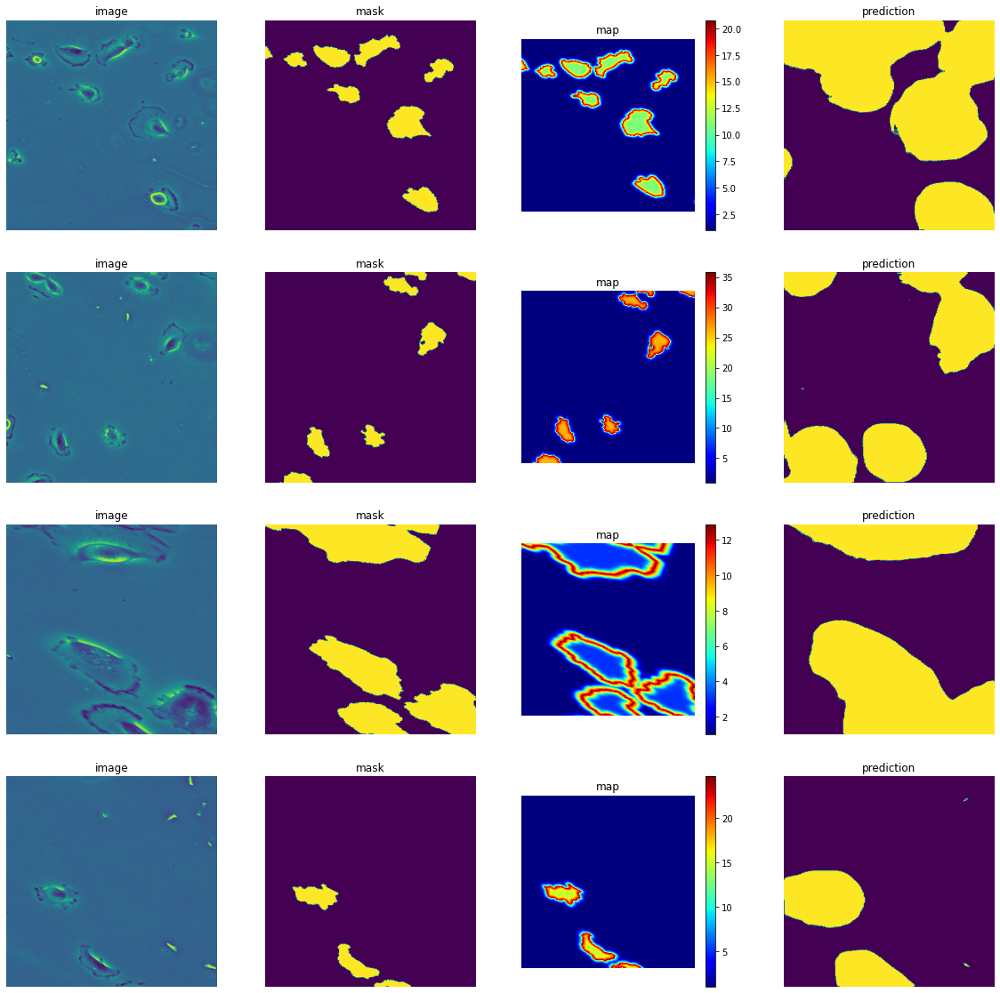

In [ ]:
# Adding train batch results
imgs, masks, weights = next(iter(train_dl))
imgs = imgs.to(device)
outputs = best_model(imgs)
outputs = outputs.cpu()
fig = plot_batch(imgs, masks, weights, outputs)
plt.show()
if record:
  writer.add_figure('Train Batch', fig)

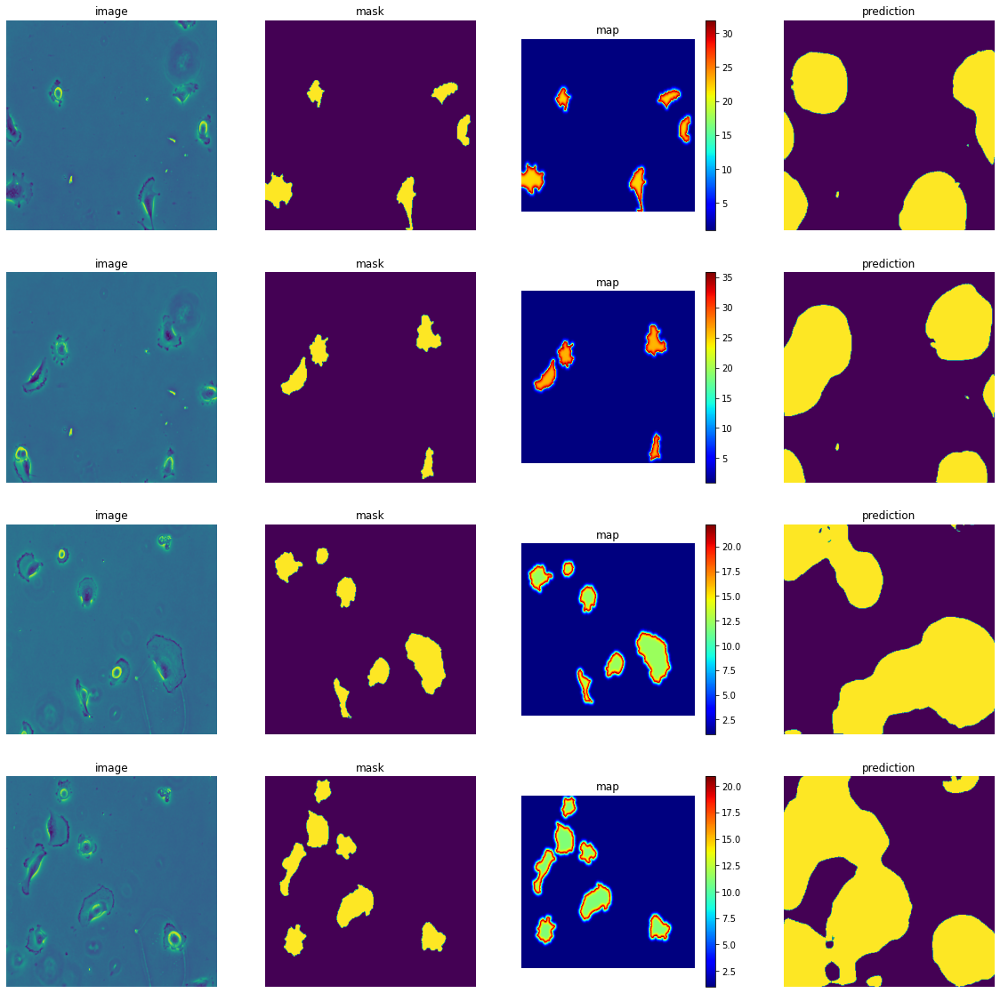

In [ ]:
# Adding test batch results
imgs, masks, weights = next(iter(test_dl))
imgs = imgs.to(device)
outputs = best_model(imgs)
outputs = outputs.cpu()
fig = plot_batch(imgs, masks, weights, outputs)
plt.show()
if record:
  writer.add_figure('Test Batch', fig)

## Training Results

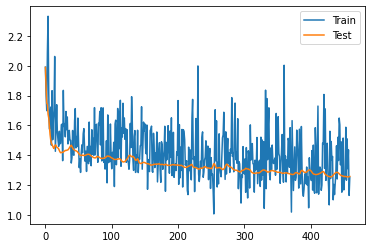

In [ ]:
fig = plt.figure()
plt.plot(range(len(train_meter.losses)),train_meter.losses, label = 'Train')
plt.plot(range(len(test_meter.losses)),test_meter.losses, label = 'Test')
plt.legend()
plt.show()
if record:
  writer.add_figure('TrainValPlot/loss', fig)

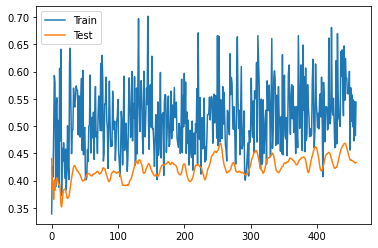

In [ ]:
fig = plt.figure()
plt.plot(range(len(train_meter.iou)),train_meter.iou, label = 'Train')
plt.plot(range(len(test_meter.iou)),test_meter.iou, label = 'Test')
plt.legend()
plt.show()
if record:
  writer.add_figure('TrainValPlot/IOU', fig)

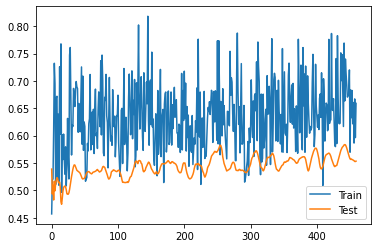

In [ ]:
fig = plt.figure()
plt.plot(range(len(train_meter.dice)),train_meter.dice, label = 'Train')
plt.plot(range(len(test_meter.dice)),test_meter.dice, label = 'Test')
plt.legend()
plt.show()
if record:
  writer.add_figure('TrainValPlot/Dice', fig)

if record:
  writer.close()

### Tensorboard

In [ ]:
tensorboard --logdir=/content/drive/MyDrive/ms_project/dataset/saved_models/uphcruns

Reusing TensorBoard on port 6006 (pid 390), started 2:37:52 ago. (Use '!kill 390' to kill it.)

<IPython.core.display.Javascript object>

# PhC Model on DIC

In [ ]:
# Load DIC
class ImgDataset(Dataset):
  def __init__(self, root, train = True):
    self.root = root
    self.train = train
    self.imgs = sorted(glob(os.path.join(root, 'DIC*/*/*.tif')))
    self.masks = sorted(glob(os.path.join(root, 'DIC*/*_GT/SEG/*.tif')))
    self.img_size = (440, 440)
    self.mask_size = (348, 348)
  
  # performing identical transform for img and mask
# https://discuss.pytorch.org/t/torchvision-transfors-how-to-perform-identical-transform-on-both-image-and-target/10606/7
  def transforms(self, img, mask, weight):
    if self.train:
      # could use random affine
      # generate random number for rotation
      img_tfms = transforms.Compose([transforms.Resize(self.img_size, interpolation=Image.BICUBIC),
                                     transforms.ToTensor(),
                                     transforms.Normalize(0.449, 0.226)])
      mask_tfms = transforms.Compose([transforms.ToTensor(),
                                      transforms.Resize(self.mask_size, interpolation=Image.NEAREST)])
      img, mask, weight = img_tfms(img), mask_tfms(mask), mask_tfms(weight)
      # Adding augmentation
      # Horizontal Flip
      if torch.rand(1) > 0.5:
        img, mask, weight = TF.hflip(img), TF.hflip(mask), TF.hflip(weight)
      # Raondom rotation
      # angle = randint(0, 360)
      # img = filledRotate(img, angle, self.img_size)
      # mask, weight = filledRotate(mask, angle, self.mask_size), filledRotate(weight, angle, self.mask_size)
      # https://www.oreilly.com/library/view/programming-pytorch-for/9781492045342/ch04.html
      # Random Affine
      # angle = randint(-30, 330)
      # shear_x, shear_y = randint(0, 20), randint(0,20)
      # img = TF.affine(img, angle = angle, translate=(0, 0), scale = 1.0, shear=(shear_x, shear_y)) 
      # mask = TF.affine(mask, angle = angle, translate=(0, 0), scale = 1.0, shear=(shear_x, shear_y))
    else:
      img_tfms = transforms.Compose([transforms.Resize(self.img_size, interpolation=Image.BICUBIC),
                                     transforms.ToTensor(),
                                     transforms.Normalize(0.449, 0.226)])
      mask_tfms = transforms.Compose([transforms.ToTensor(), 
                                      transforms.Resize(self.mask_size, interpolation=Image.NEAREST)])
      img, mask, weight = img_tfms(img), mask_tfms(mask), mask_tfms(weight)
    return img, mask, weight

  def __getitem__ (self, id):
    img_path = self.imgs[id]
    mask_path = self.masks[id]

    img = Image.open(img_path)
    mask = Image.open(mask_path)
    # Cropping augmentation
    # if self.train:
    #   top, left, height, width = find_crop_region(mask)
    #   img = TF.crop(img, top, left, height, width)
    #   mask = TF.crop(mask, top, left, height, width)
      

    mask = np.array(mask)
    # Not instance aware
    # Masks contain background and cells. background is 0th postion, cell is 1st position
    mask = np.where(mask > 0, 1, 0)
    weight = distance_mask(mask)
    
    img, mask, weight = self.transforms(img, mask, weight)
    mask = torch.as_tensor(mask, dtype=torch.long).squeeze()
    weight = weight.squeeze()
    return img, mask, weight

  def __len__(self):
    return len(self.imags)


In [ ]:
# train test split
image_list = sorted(glob(os.path.join(BASE_DIR, 'DIC*/*/*.tif')))
torch.manual_seed(1)
indices = torch.randperm(len(image_list)).tolist()
# 20% 80% split
split = indices[:int(len(image_list) * 0.8)]
train_list = [item for ind, item in enumerate(image_list) if ind in split]
test_list = [item for ind, item in enumerate(image_list) if ind not in split]
# using the training set for channel mean
# channel_mean, channel_std = img_stat(train_list)
# print(channel_mean, channel_std)

# Prepare train/test dataset
train_set = ImgDataset(BASE_DIR, train=True)
test_set = ImgDataset(BASE_DIR, train = False)
train_set = torch.utils.data.Subset(train_set, indices[:int(len(image_list) * 0.8)])
test_set = torch.utils.data.Subset(test_set, indices[int(len(image_list) * 0.8):])

####################################
# Smaller set for debugging
# train_set = torch.utils.data.Subset(train_set, range(500))
# test_set = torch.utils.data.Subset(test_set, range(100))
####################################


# Prepare dataloader
batch_size = 4
train_dl = DataLoader(train_set, batch_size = batch_size, shuffle = True,
                      pin_memory=torch.cuda.is_available(), num_workers=0)
test_dl = DataLoader(test_set, batch_size = batch_size, shuffle = False, pin_memory=torch.cuda.is_available(), num_workers=0)

In [ ]:
best_model = UNet(1,2)
best_model = best_model.to(device)
best_model.load_state_dict(torch.load('/content/drive/My Drive/ms_project/dataset/saved_models/2021022121:23:02-Smaller-UNet-PhC'))

criterion = ShapeAwareLoss()
with torch.no_grad():
  loss, iou, dice = validate(test_dl, best_model, criterion)
text = 'Validation Loss:{:.2f} IOU: {:.4f} Dice: {:.4f}'.format(loss, iou.cpu(), dice.cpu())
print(text)

Validation Loss:2.41 IOU: 0.5817 Dice: 0.7298


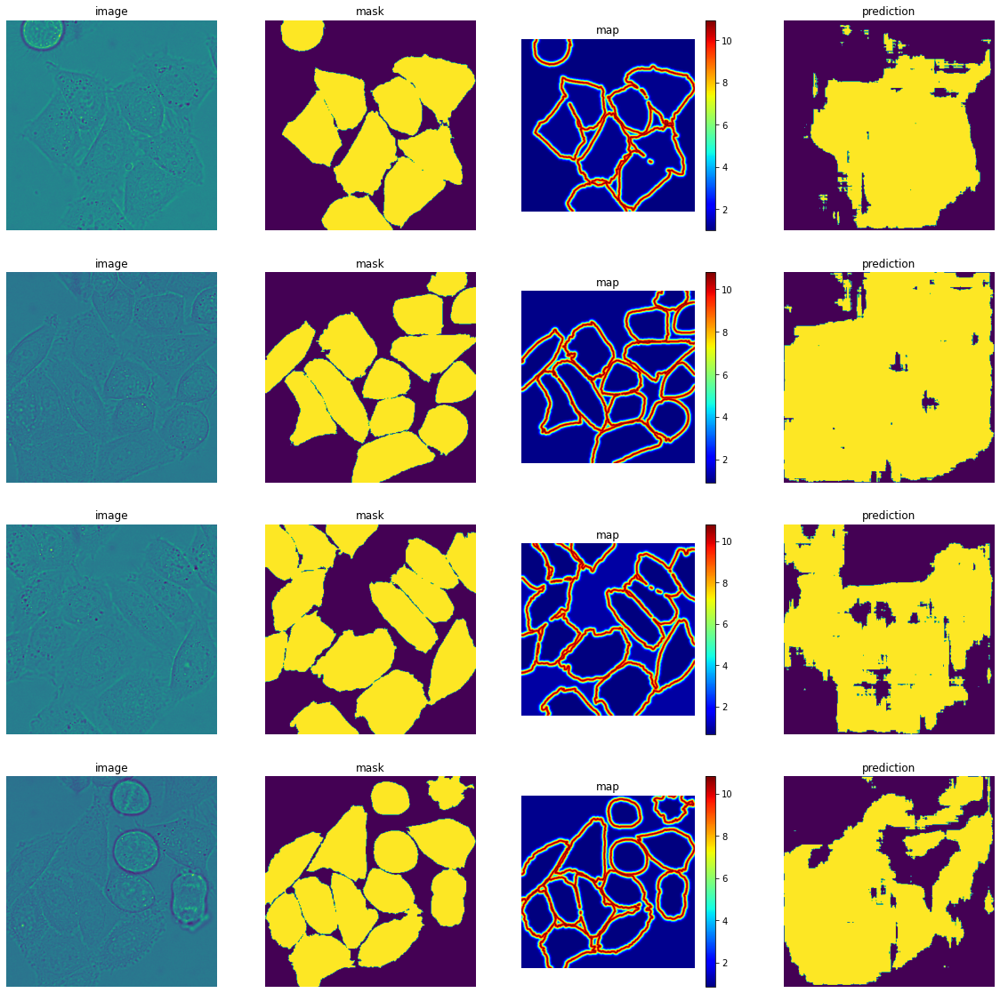

In [ ]:
images, masks, weights = next(iter(test_dl))# Adding test batch results
imgs, masks, weights = next(iter(test_dl))
imgs = imgs.to(device)
with torch.no_grad():
  outputs = best_model(imgs)
outputs = outputs.cpu()
fig = plot_batch(imgs, masks, weights, outputs)
plt.show()